In [1]:
import pandas as pd
import numpy as np
import os
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import RandomForestClassifier
import matplotlib.pyplot as plt
import seaborn as sns
import random
import plotly.express as px
import random

import warnings
warnings.filterwarnings('ignore')

In [2]:
df = pd.read_csv('Dataset.csv')
df_d = df.copy()

In [3]:
# plt.figure(figsize=(12,8))
# corr_mat = df.corr()
# sns.heatmap(corr_mat, annot=True)
# plt.show()

No high correlation found in the dataset among any feature, we are okay to use all the features to train our model.

In [4]:
# for column in df:
#     plt.figure()
#     try:
#         df.boxplot([column])
#     except:
#         print("plot can't be drawn for : ", column)

Looking at the outliers we find that these columns "rerecreation, rentadjustment, shelter, wage" have good amount of outliers present into them. Since all the 4 features are connected to the basic needs of a human, we are going to remove outliers but to an extent. Removing all the outliers would make our data unrealistic. 

In [5]:
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()

In [6]:
copydf = df
copydf.interestGroup = le.fit_transform(copydf.interestGroup)
copydf.haveKids = le.fit_transform(copydf.haveKids)

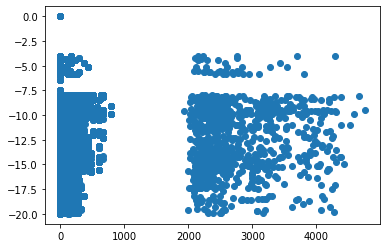

In [7]:
import matplotlib.pyplot as plt
%matplotlib inline
plt.scatter(copydf['Wage'],copydf['Food'])#,copydf['Recreation'],copydf['RentAdjustment'],copydf['Shelter'],copydf['Wage'])

In [8]:
copydf1 = copydf.copy()
copydf1['date'] = copydf1['date'].astype('str')
copydf = copydf.drop(columns= ['participantId','date'])

In [9]:
df_y = copydf['joviality']
X_train, X_test, y_train, y_test = train_test_split(copydf.drop('joviality',axis=1),df_y,test_size=0.2)

In [10]:
# Applying PCA function on training and testing set of X component
# from sklearn.decomposition import PCA

# pca = PCA(n_components = 2)

# X_train = pca.fit_transform(X_train)
# X_test = pca.transform(X_test)

# explained_variance = pca.explained_variance_ratio_

In [11]:
model_reg = RandomForestRegressor(n_estimators=40)
model_reg.fit(X_train, y_train)

RandomForestRegressor(n_estimators=40)

In [12]:
model_reg.score(X_test,y_test)

0.9925379110132996

In [13]:
y_predicted = model_reg.predict(X_test)

In [14]:
model_reg.predict(X_test)

array([0.87466174, 0.49019034, 0.66745486, ..., 0.99767084, 0.49545327,
       0.68637492])

In [15]:
model_reg.feature_importances_

array([5.15616198e-05, 4.22684039e-01, 9.81464636e-03, 3.76785769e-05,
       5.29521069e-04, 2.37239383e-01, 4.14996350e-02, 7.55698833e-03,
       1.42351051e-01, 4.54368726e-02, 9.27986234e-02])

#### developing classification model based on financial status

In [16]:
df_jov = copydf1.copy()

In [17]:
path = r"E:\Ven Analytics Storage\New folder\Activity Logs\ParticipantStatusLogs"
all_als = {}
for i in [1,2,6,7,72]:
    df = pd.read_csv(path + str(i)+".csv")
    all_als["al_"+str(i)] = df
    
cdf = pd.DataFrame()
# for key in all_als.keys():
for key in ['al_1','al_2','al_6','al_7','al_72']:
    if len(all_als[key]['financialStatus'].unique()) > 1:
        print("df suffix is : ", key)
        cdf = cdf.append(all_als[key])
        
cdf_2 = cdf.copy()

df suffix is :  al_1
df suffix is :  al_2
df suffix is :  al_6
df suffix is :  al_7
df suffix is :  al_72


In [18]:
tomdf = cdf[['timestamp','participantId','financialStatus']]
tomdf = tomdf.rename(columns={'timestamp':'date'})
tomdf['date'] = tomdf['date'].astype('str')
tomdf['date'] = tomdf['date'].str[:10]
tomdf['date'] = tomdf['date'].str.replace("-","")

In [19]:
print('Length of activity logs data is : ',len(tomdf))
print('where the unique counts of stable vs unstable is : ', tomdf['financialStatus'].value_counts())

Length of activity logs data is :  6913218
where the unique counts of stable vs unstable is :  Stable      6744350
Unstable     127970
Unknown       40896
Name: financialStatus, dtype: int64


In [20]:
# Putting the Unknown category of financial status into the 'Unstable' category

In [21]:
tomdf['financialStatus'] = tomdf['financialStatus'].replace({'Unknown':'Unstable'}) 

In [22]:
print('Now unique counts of stable vs unstable is : ', tomdf['financialStatus'].value_counts())

Now unique counts of stable vs unstable is :  Stable      6744350
Unstable     168866
Name: financialStatus, dtype: int64


In [23]:
# mgdf = pd.merge(copydf1,tomdf,on=['participantId','date']).drop_duplicates()
mgdf = copydf1.merge(tomdf, on=['participantId','date'], how='left').drop_duplicates()

# left join - fin status(if null - dont train it)
df_fin = mgdf.copy()

In [24]:
# mgdf['date'] = mgdf['date'].str[:6]

<Axes: >

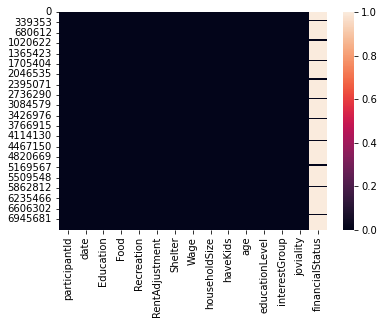

In [25]:
sns.heatmap(mgdf.isnull())

#use LSTM to maintain the balance of financial statuses

In [26]:
mgdf_nn = mgdf[mgdf.financialStatus.notnull()].reset_index().drop(columns=['index'])
mgdf_in = mgdf[mgdf.financialStatus.isnull()].reset_index().drop(columns=['index'])

In [27]:
mgdf_nn_1 = mgdf_nn.copy()
mgdf_nn = mgdf_nn.drop(columns=['participantId','date','joviality']).dropna()
mgdf_nn = mgdf_nn.dropna()

In [28]:
y_dat = mgdf_nn['financialStatus']
X_train, X_test, y_train, y_test = train_test_split(mgdf_nn.drop(columns=['financialStatus']),y_dat,test_size=0.2)

# pca = PCA(n_components = 2)
# X_train = pca.fit_transform(X_train)
# X_test = pca.transform(X_test)

model_cla = RandomForestClassifier(n_estimators=2)
model_cla.fit(X_train, y_train)

model_cla.score(X_test, y_test)

0.9938934122871946

In [29]:
#predicting the financial status for the 
old_topred_data = mgdf_in.drop(columns=['participantId','date','joviality','financialStatus']).dropna()

pred_old_topred_data = pd.DataFrame({"y_pred_old_topred_data":model_cla.predict(old_topred_data)})
mgdf_in['financialStatus'] = pred_old_topred_data['y_pred_old_topred_data']

In [30]:
final_old_data = pd.concat([mgdf_nn_1 , mgdf_in])

In [31]:
print('total null counts in the df are : ', final_old_data.isnull().sum())
print('unique counts of financial status are : ', final_old_data.financialStatus.value_counts())
final_old_data.head()
fut_data = final_old_data.copy()

total null counts in the df are :  participantId      0
date               0
Education          0
Food               0
Recreation         0
RentAdjustment     0
Shelter            0
Wage               0
householdSize      0
haveKids           0
age                0
educationLevel     0
interestGroup      0
joviality          0
financialStatus    0
dtype: int64
unique counts of financial status are :  Stable      395429
Unstable      1272
Name: financialStatus, dtype: int64


# Generating Future Data

In [32]:
gfd_df = fut_data.copy()

In [33]:
gfd_df.drop(columns=['joviality','financialStatus'],inplace=True)

In [34]:
cat_data = gfd_df[['participantId','householdSize','haveKids','age','educationLevel','interestGroup']]
cur_cat_data = cat_data.groupby(['participantId']).mean().reset_index()
#Categorical data has been generated for the dataframe.

In [35]:
#Generating Continuous data based on calculating the CAGR and then estimating the coming year data
ddfin = gfd_df[['participantId','date','Education','Food','Recreation','RentAdjustment','Shelter','Wage']]
ddfin['date'] = ddfin['date'].str[:6]

In [36]:
ddfin = ddfin.groupby(['participantId','date']).sum().reset_index()

In [37]:
cur_df = pd.DataFrame()
pids = ddfin['participantId'].unique()
for ppt in pids:
    wdf = ddfin[ddfin['participantId'] == ppt]
    wdf =  wdf.reset_index()
    wdf = wdf.drop(columns = ['index'])
    for c in wdf.columns:
        if c not in ['participantId', 'date']:
            cagr = (wdf[c][len(wdf)-1] / wdf[c][0])**(1/len(wdf)) - 1
#             print('cagr is at ', cagr, ": ", c, ": id is", ppt)
            wdf[c+"_cagr"] = cagr
    cur_df = cur_df.append(wdf)

cur_df_1 = cur_df.copy()

In [38]:
dfcols = ['participantId', 'date', 'Education', 'Food', 'Recreation','RentAdjustment', 'Shelter', 'Wage']
for mcol in dfcols:
    if mcol not in ['participantId', 'date']:
        cur_df[mcol] = cur_df[mcol] + cur_df[mcol]*cur_df[mcol+"_cagr"]
        
cur_df.fillna(0, inplace=True)

In [39]:
cur_df22 = cur_df[['participantId','date','Education', 'Food', 'Recreation','RentAdjustment', 'Shelter', 'Wage']]

for mcol in cur_df22.columns:
    if mcol not in ['participantId', 'date']:
        cur_df22[mcol] = cur_df22[mcol].abs()

In [40]:
cur_fin_Data= pd.merge(cur_df22, cur_cat_data , on=['participantId'])
cur_fin_Data.head()

asdfsafd = pd.merge(cur_cat_data, cur_df22 , on='participantId')

In [41]:
asdfsafd.isnull().sum()

participantId     0
householdSize     0
haveKids          0
age               0
educationLevel    0
interestGroup     0
date              0
Education         0
Food              0
Recreation        0
RentAdjustment    0
Shelter           0
Wage              0
dtype: int64

In [42]:
joviality_pred = model_reg.predict(asdfsafd.drop(columns=['participantId','date']))
finstatus_pred = model_cla.predict(asdfsafd.drop(columns=['participantId','date']))

In [43]:
asdfsafd['joviality_pred'] = joviality_pred
asdfsafd['finstatus_pred'] = finstatus_pred

In [44]:
asdfsafd['Expenses']  = 0
for cc in ['Education','Food','Recreation','RentAdjustment','Shelter']:
    asdfsafd['Expenses'] = asdfsafd['Expenses'] + asdfsafd[cc]

In [45]:
asdfsafd['date'] = asdfsafd['date'].str.replace('2023','2024')
asdfsafd['date'] = asdfsafd['date'].str.replace('2022','2023')

predicted = asdfsafd.copy()

edu_levels = {1:'Low',2:'HighSchoolOrCollege', 3:'Bachelors', 4:'Graduate'}
have_kids = {1:'True',2:'False'}
predicted['educationLevel'].replace(edu_levels, inplace=True)
predicted['haveKids'].replace(have_kids, inplace=True)

In [46]:
fig = px.scatter(predicted, x='Wage', y='Expenses',animation_frame='date', animation_group='participantId',range_x=[1000,16000], range_y=[-100,3000], title='Wage vs Expenses')
fig.show()

###### Drawing some plots based on the various categories available

In [73]:
fig = px.scatter(predicted, x='Wage', y='Expenses',animation_frame='date', animation_group='participantId',color='educationLevel',range_x=[1000,16000], range_y=[-100,3000], title='Wage vs Expenses scatter plot (Education Level)')
fig.show()
fig = px.scatter(predicted, x='Wage', y='Expenses',animation_frame='date', animation_group='participantId',color='age_group',range_x=[1000,16000], range_y=[-100,3000], title='Wage vs Expenses scatter plot (Age)')
fig.show()
fig = px.scatter(predicted, x='Wage', y='Expenses',animation_frame='date', animation_group='participantId',color='haveKids',range_x=[1000,16000], range_y=[-100,3000], title='Wage vs Expenses scatter plot (Have kids)')
fig.show()
fig = px.scatter(predicted, x='Wage', y='Expenses',animation_frame='date', animation_group='participantId',color='householdSize',range_x=[1000,16000], range_y=[-100,3000], title='Wage vs Expenses scatter plot (House hold size)')
fig.show()
fig = px.scatter(predicted, x='Wage', y='Expenses',animation_frame='date', animation_group='participantId',color='interestGroup',range_x=[1000,16000], range_y=[-100,3000], title='Wage vs Expenses scatter plot (interest group)')
fig.show()

Here we see that all the plots are scattered in an legitimate way of living.
There are a few things to note from each plot, as below:<br>
    1. Education level - the lower the education level , the lower will be the wages so as the expenses. However, we see that the expenses are varying to the full range no matter their wages are low.<br>
    2. Age Group  - In this plot wages and expenses both are scattered that we don't see any specific pattern. That also shows that in real life also, all age people earn as well as spend money throughout the range.<br>
    3. Have Kids - Here we see an interesting pattern which is the obvious thing. Those who don't have kids are shifted to lower wages and lower expenses and vice versa.<br>
    4. house hold size - Here as well, the lower the household size , the lower will be the expenses and the wages.

In [48]:
categs = ["0-18 group","19-25 group", "26-35 group", "36-50 group", "50-70 group", "70+ group"]
predicted.loc[(predicted.age <= 18),  'age_group'] = categs[0]
predicted.loc[((predicted.age > 18) & (predicted.age <= 25)),  'age_group'] = categs[1]
predicted.loc[((predicted.age > 25) & (predicted.age <= 35)),  'age_group'] = categs[2]
predicted.loc[((predicted.age > 35) & (predicted.age <= 50)),  'age_group'] = categs[3]
predicted.loc[((predicted.age > 50) & (predicted.age <= 70)),  'age_group'] = categs[4]
predicted.loc[(predicted.age >70),  'age_group'] = categs[5]
px.scatter(predicted, x='Wage', y='Expenses',animation_frame='date', animation_group='participantId',color='age',range_x=[1000,16000], range_y=[-100,3000], title='Wage vs Expenses scatter plot')
#create age_groups 
#Expenses are higher for the people having bigger household size and vice-versa

In [49]:
px.scatter(predicted, x='Wage', y=['Food','Education','Recreation','RentAdjustment','Shelter'],animation_frame='date', animation_group='participantId')

In [50]:
pred_W_E = predicted[['date','Wage','Expenses']].groupby('date').mean()

In [51]:
copydf1['Expenses']  = 0
for cc in ['Education','Food','Recreation','RentAdjustment','Shelter']:
    copydf1[cc] = copydf1[cc].abs()
    copydf1['Expenses'] = copydf1['Expenses'] + copydf[cc] 

In [52]:
copydf1['date'] = copydf1['date'].str[:6]

ordf = copydf1[['participantId','date','Wage','Expenses']].groupby(['participantId','date']).sum().abs()

In [53]:
ordf = ordf.reset_index()
orig_W_E = ordf.groupby('date').mean()

In [54]:
orig_W_E =orig_W_E.reset_index()
pred_W_E = pred_W_E.reset_index()

In [55]:
orig_W_E_1 = orig_W_E[~orig_W_E['date'].isin(['202303','202304','202305'])]

In [56]:
W_E_1 = pd.concat([orig_W_E_1,pred_W_E])

colors=['Predicted' if val > '202302' else 'Original' for val in W_E_1['date']]

fig = px.line(W_E_1 , x='date', y=['Wage','Expenses'],markers=True, title='Plot showing the Wages vs Expenses of original and Curated Data')
fig.update_layout(plot_bgcolor="white", yaxis_title="Amount")
for i, d in enumerate(fig.data):
    fig.add_scatter(x=[d.x[-1]], y = [d.y[-1]],
                    mode = 'markers+text',
                    text = np.round(d.y[-1], 2),
                    textfont = dict(color=d.line.color),
                    textposition='middle right',
                    marker = dict(color = d.line.color, size = 12),
                    legendgroup = d.name,
                    showlegend=False)
fig.show()

#put (p) at the timeline in curated data

In [57]:
# px.line(orig_W_E , x='date', y=['Wage','Expenses'], markers=True, title='Wage vs Expenses - Original Data')
# px.line(pred_W_E , x='date', y=['Wage','Expenses'], markers=True, title='Wage vs Expenses - Predicted Data')

###### Average joviality of the participants by age group

In [58]:
avg_jov_agegroup = asdfsafd.copy()

In [59]:
jov_pr = avg_jov_agegroup[['date','joviality_pred','age']].groupby(['date','age']).mean().reset_index()

In [60]:
jov_org = df_jov.copy()
jov_org['date'] = df_jov['date'].str[:6]
jov_org = jov_org[['date','joviality','age']].groupby(['date','age']).mean().reset_index()

In [61]:
jov_org = jov_org.drop(columns=['date'])
jov_pr = jov_pr.drop(columns=['date'])
ee = pd.merge(jov_org,jov_pr,on=['age']).drop_duplicates()

In [62]:
categs = ["0-18 group","19-25 group", "26-35 group", "36-50 group", "50-70 group", "70+ group"]
ee.loc[(ee.age <= 18),  'age_group'] = categs[0]
ee.loc[((ee.age > 18) & (ee.age <= 25)),  'age_group'] = categs[1]
ee.loc[((ee.age > 25) & (ee.age <= 35)),  'age_group'] = categs[2]
ee.loc[((ee.age > 35) & (ee.age <= 50)),  'age_group'] = categs[3]
ee.loc[((ee.age > 50) & (ee.age <= 70)),  'age_group'] = categs[4]
ee.loc[(ee.age >70),  'age_group'] = categs[5]

fig = px.bar(ee, x='age_group', y=['joviality','joviality_pred'],title="Average joviality of the participants by age group",barmode='group')
fig.update_layout(plot_bgcolor="white", yaxis_title="joviality")
fig.update_traces(textposition="outside")
fig.show()

###### overall number of joviality  - last year vs this year

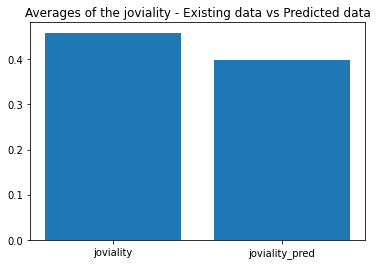

In [63]:
ee_ovr = ee[['joviality','joviality_pred']].reset_index()
plt.bar(['joviality','joviality_pred'],[np.mean(ee_ovr['joviality']),np.mean(ee_ovr['joviality_pred'])])
plt.title('Averages of the joviality - Existing data vs Predicted data')
plt.show()

###### Average joviality of the people by education level

In [64]:
avg_jov_edu = asdfsafd.copy()

In [65]:
jov_pr_edu = avg_jov_edu[['date','joviality_pred','educationLevel']].groupby(['date','educationLevel']).mean().reset_index()

In [66]:
jov_org_edu = df_jov.copy()
# jov_org_edu.head()

In [67]:
jov_org_edu['date'] = jov_org_edu['date'].str[:6]
jov_org_edu = jov_org_edu[['date','joviality','educationLevel']].groupby(['date','educationLevel']).mean().reset_index()
jov_org_edu = jov_org_edu.drop(columns=['date'])
jov_pr_edu = jov_pr_edu.drop(columns=['date'])
eec = pd.merge(jov_org_edu,jov_pr_edu,on=['educationLevel']).drop_duplicates()

In [68]:
edu_levels = {1:'Low',2:'HighSchoolOrCollege', 3:'Bachelors', 4:'Graduate'}
eec['educationLevel'].replace(edu_levels, inplace=True)

fig = px.bar(eec, x='educationLevel', y=['joviality','joviality_pred'], title="Average joviality of the participants by education Level",barmode='group', text_auto=True)
fig.update_layout(plot_bgcolor="white", yaxis_title="joviality")
fig.update_traces(textposition="outside")
fig.show()

###### Percentage of stable vs non stable persons (original vs curated data)

In [69]:
s_u_count_org = df_fin.copy()
s_u_count_pred = asdfsafd.copy()
df_fin['financialStatus'].value_counts().to_dict()

piedf = pd.DataFrame({"category":['Stable','Unstable'], "Count":[26366,650]})

fig = px.bar(piedf, x='category',y='Count', title='Counts of Stable and Unstable people')
fig.show()

#histograms 

In [70]:
import plotly.graph_objects as go

fig = go.Figure()
fig.add_trace(go.Indicator(
    mode = "number+delta",
    value = 1370,
    domain = {'x': [0, 0.5], 'y': [0, 0.5]},
    delta = {'reference': 1000, 'relative': True, 'position' : "top"}))

fig.add_trace(go.Indicator(
    mode = "number+delta",
    value = 796,
    delta = {'reference': 1000, 'relative': True},
    domain = {'x': [0, 0.5], 'y': [0.5, 1]}))
fig.show()

###### Travel Journal Plots

In [71]:
Jrnl_folder = r"C:\Users\kp779\Desktop\OneDrive - venanalytics.io\VenAnalytics\Tejal Bijwe\Journals\\"

##### 1. Travel Journal Data
df_TravelJournal = pd.read_csv(Jrnl_folder+"TravelJournal.csv")

df_TravelJournal['travelStartTime'] = pd.to_datetime(df_TravelJournal['travelStartTime'])
df_TravelJournal['travelEndTime'] = pd.to_datetime(df_TravelJournal['travelEndTime'])

df_TravelJournal['Duration(mins)'] = (df_TravelJournal['travelEndTime'] - df_TravelJournal['travelStartTime']).astype('timedelta64[m]')

trv_pd = df_TravelJournal[['participantId','travelStartTime','purpose', 'Duration(mins)']]
trv_pd['travelStartTime'] = trv_pd['travelStartTime'].astype('str')
trv_pd['travelStartTime'] = trv_pd['travelStartTime'].str[:7]

# trv_pd_1 = trv_pd.groupby(['travelStartTime', 'purpose']).mean().reset_index()
trv_pd_1 = trv_pd.groupby(['participantId','travelStartTime','purpose']).sum().reset_index()
trv_pd_1 = trv_pd_1.drop(columns= ['participantId']).groupby(['travelStartTime','purpose']).mean().reset_index()

fig = px.line(trv_pd_1 , x= 'travelStartTime', y = 'Duration(mins)', color='purpose', title="Average Travel time by purpose of travel")
fig.update_layout(plot_bgcolor="white")
fig.show()

df_TravelJournal['Spends'] = df_TravelJournal['startingBalance'] - df_TravelJournal['endingBalance']

trv_sd = df_TravelJournal[['participantId','travelStartTime','purpose', 'Spends']]
trv_sd['travelStartTime'] = trv_sd['travelStartTime'].astype('str')
trv_sd['travelStartTime'] = trv_sd['travelStartTime'].str[:7]

# trv_sd_1 = trv_sd.groupby(['travelStartTime', 'purpose']).mean().reset_index()
trv_sd_1 = trv_sd.groupby(['participantId','travelStartTime','purpose']).sum().reset_index()
trv_sd_1 = trv_sd_1.drop(columns= ['participantId']).groupby(['travelStartTime','purpose']).mean().reset_index()

trv_sd_1['Spends'] = trv_sd_1['Spends'].abs()

fig = px.line(trv_sd_1 , x= 'travelStartTime', y = 'Spends', color='purpose', title="Average Spends by purpose of travel")
fig.update_layout(plot_bgcolor="white")
fig.show()

In [72]:
#Headers must be meaningful and have insights of the plot